# <center> **Image Processing on Messier 77 Galaxy**


In [ ]:
!pip install bm3d

In [ ]:
!pip install astropy

In [ ]:
!pip install astroquery

In [ ]:
import urllib.request
import cv2
import bm3d
from skimage import io, img_as_float
from skimage.filters import median, meijering, sato, frangi, hessian
from skimage.morphology import disk
from astropy.io import fits
import astropy
import matplotlib.pyplot as plt
import numpy as np
from astroquery.skyview import SkyView
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
import sklearn
from sklearn.preprocessing import normalize, StandardScaler
from astropy.visualization import ZScaleInterval
from skimage.filters import roberts, sobel, scharr, prewitt
from skimage.filters import meijering,sato
from scipy.fft import fft2, fftshift
from skimage import feature

In [ ]:
hdu = SkyView.get_images("NGC 1068", survey='SDSSg')[0][0]

literature survey

In [ ]:
'''
1) Messier 77 (M77), also known as NGC 1068 or the Squid Galaxy, is a barred spiral galaxy in the constellation Cetus.
It is about 47 million light-years (14 Mpc) away from Earth. Messier 77 was discovered by Pierre Méchain in 1780,
who originally described it as a nebula. Today, however, the object is known to be a galaxy.

2) As given in the header information the quitorial longitude and latitude measured along J2000.0 frame are 40.6696292 and -0.0132806
respectively. However the galactic longitude and latitude are 172.1037384 and -51.9337526.

3) NGC 1068 is one of the brightest galaxies in the sky and is easily visible with amateur telescopes. It is located in the constellation
 Cetus and has an apparent magnitude of around 9.6. In terms of size, NGC 1068 has a diameter of approximately 170,000 light-years,
 making it a large and prominent galaxy.
 The nucleus of NGC 1068 is highly active and is classified as a Seyfert Type 2 AGN. It exhibits intense emission in various wavelengths,
 including X-rays and radio waves. The AGN activity is thought to be fueled by the accretion of matter onto a supermassive black hole at
 the center of the galaxy.

4) Research about this galaxy: a) Barred Spiral Galaxy. (b) The morphological classification of NGC 1068 in the De Vaucouleurs system
is (R)SA(rs)b, where the '(R)' indicates an outer ring-like structure, 'SA' denotes a non-barred spiral, '(rs)' means a transitional
inner ring/spiral structure, and 'b' says the spiral arms are moderately wound. (c) It is an active galaxy with an active galactic
nucleus (AGN), which is obscured from view by astronomical dust at visible wavelengths. (d) It is hiding a supermassive black hole at
its center.

5) Hypothesis: It is a spiral galaxy which contains black hole in its center.

'''

"\n1) Messier 77 (M77), also known as NGC 1068 or the Squid Galaxy, is a barred spiral galaxy in the constellation Cetus. \nIt is about 47 million light-years (14 Mpc) away from Earth. Messier 77 was discovered by Pierre Méchain in 1780, \nwho originally described it as a nebula. Today, however, the object is known to be a galaxy.\n\n2) As given in the header information the quitorial longitude and latitude measured along J2000.0 frame are 40.6696292 and -0.0132806\nrespectively. However the galactic longitude and latitude are 172.1037384 and -51.9337526.\n\n3) NGC 1068 is one of the brightest galaxies in the sky and is easily visible with amateur telescopes. It is located in the constellation\n Cetus and has an apparent magnitude of around 9.6. In terms of size, NGC 1068 has a diameter of approximately 170,000 light-years, \n making it a large and prominent galaxy.\n The nucleus of NGC 1068 is highly active and is classified as a Seyfert Type 2 AGN. It exhibits intense emission in var

EDA

In [ ]:
hdu.header # Extracting the header data of the file

SIMPLE  =                    T / Written by SkyView Fri Jul 07 23:54:06 EDT 2023
BITPIX  =                  -32 / 4 byte floating point                          
NAXIS   =                    2 / Two dimensional image                          
NAXIS1  =                  300 / Width of image                                 
NAXIS2  =                  300 / Height of image                                
CRVAL1  =              40.6696 / Reference longitude                            
CRVAL2  =            -0.013296 / Reference latitude                             
RADESYS = 'FK5     '           / Coordinate system                              
EQUINOX =               2000.0 / Epoch of the equinox                           
CTYPE1  = 'RA---TAN'           / Coordinates -- projection                      
CTYPE2  = 'DEC--TAN'           / Coordinates -- projection                      
CRPIX1  =                150.5 / X reference pixel                              
CRPIX2  =                150

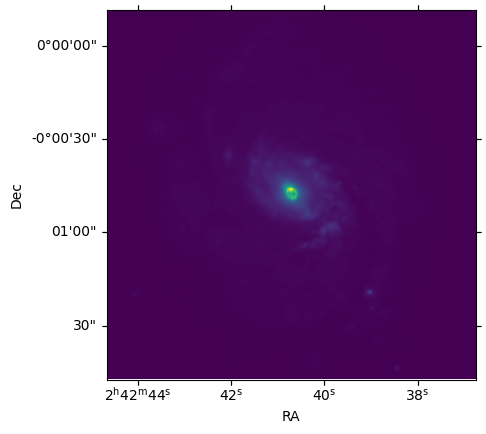

In [ ]:
# Extracting the coordinates
wcs = WCS(hdu.header)
fig = plt.figure()
ax = fig.add_subplot(projection=wcs)

# Ploting the image with coordinates
ax.imshow(hdu.data)
ax.set(xlabel="RA", ylabel="Dec")
plt.show()

In [ ]:
NGC1068_data = hdu.data # Extracting data of the file

Text(0.5, 1.0, 'NGC 1068 Galaxy')

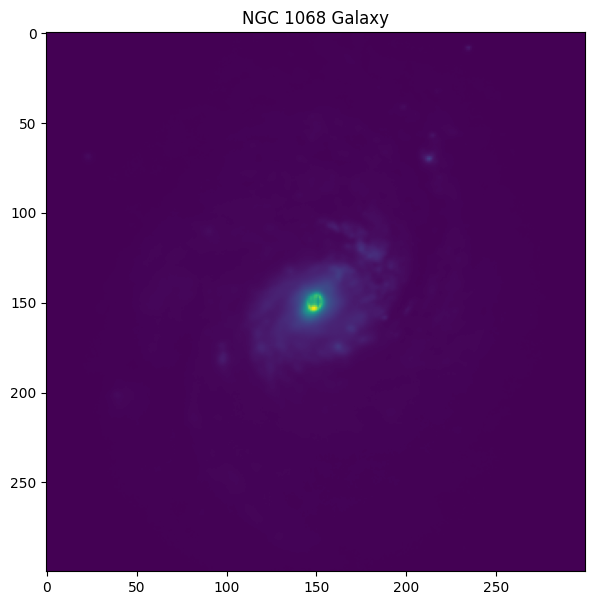

In [ ]:
# Plotting the galaxy image
plt.figure(figsize=(7,7))
plt.imshow(NGC1068_data)
plt.title('NGC 1068 Galaxy')

In [ ]:
NGC1068_data.shape # shape of the image

(300, 300)

In [ ]:
# Printing the minimum value, maximum value, mean value and standard deviation value of the image data
print('min:', np.min(NGC1068_data))
print('max:', np.max(NGC1068_data))
print('mean:', np.mean(NGC1068_data))
print('std:', np.std(NGC1068_data))

min: 0.04663086
max: 122.125
mean: 1.4553101
std: 3.8551211


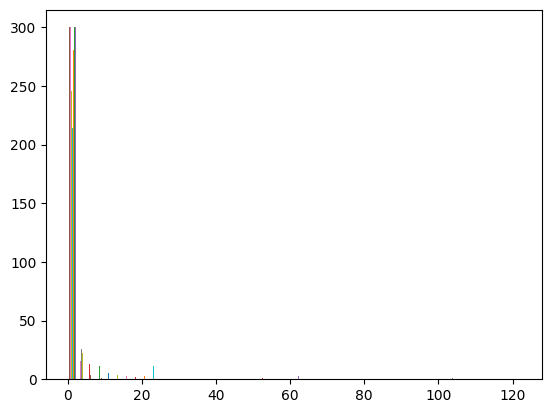

In [ ]:
histogram = plt.hist(NGC1068_data, bins=50) # plotting histogram to see the data distribution

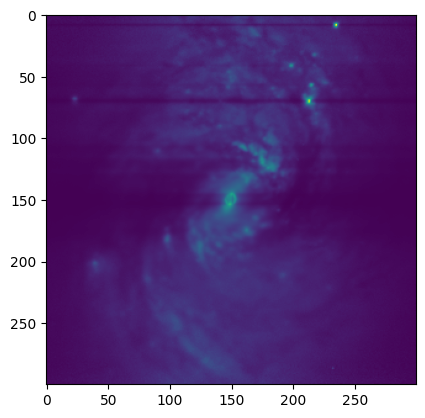

In [ ]:
#  Normalizing the data points and then visualising the normalized image
NGC1068_norm_data = normalize(NGC1068_data)
plt.imshow(NGC1068_norm_data)

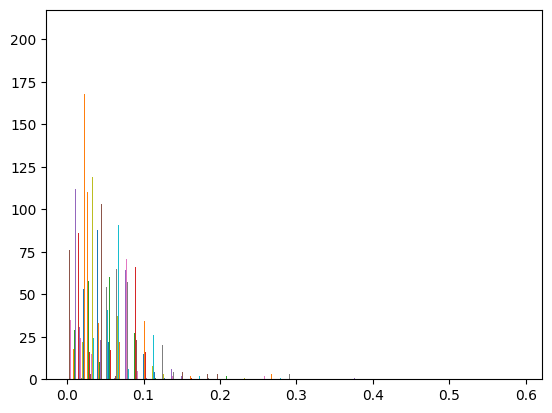

In [ ]:
histogram_norm = plt.hist(NGC1068_norm_data, bins=50) # histogram of normalized data

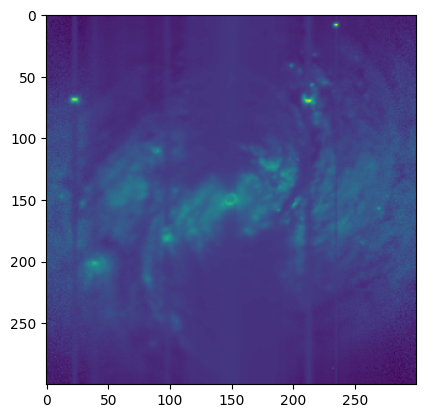

In [ ]:
# Standardizing the image data and visualizing the image
scaler = StandardScaler()
scaler.fit(NGC1068_data)
NGC1068_ss_data = scaler.transform(NGC1068_data)
plt.imshow(NGC1068_ss_data)

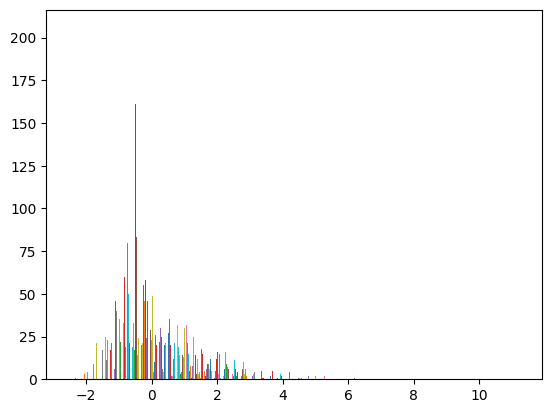

In [ ]:
histogram_ss = plt.hist(NGC1068_ss_data, bins=50) # histogram of standardized data

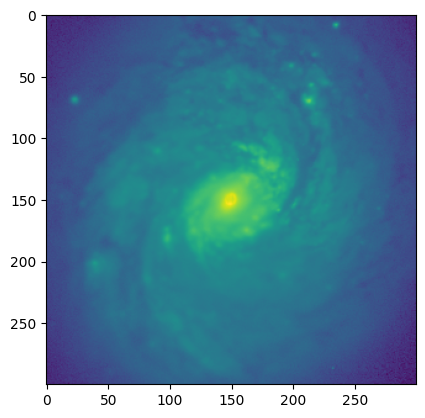

In [ ]:
# applying log to normalize the data
NGC1068_log_data = np.log(NGC1068_data)
plt.imshow(NGC1068_log_data)

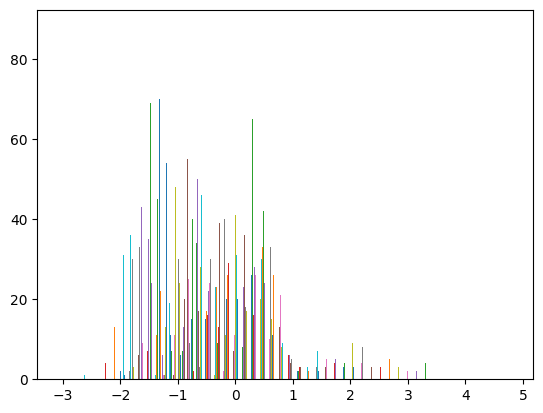

In [ ]:
histogram_log = plt.hist(NGC1068_log_data, bins=50) # histogram of log normalized data

0.084472656 4.251956703466995


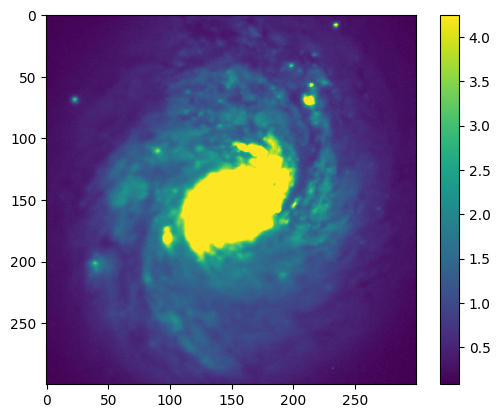

In [ ]:
# Applying Z scale on the original image data and visualizing it
zscale_interval = ZScaleInterval()
z1,z2 = zscale_interval.get_limits(NGC1068_data) # extracting z scale limits
print(z1,z2)
plt.imshow(NGC1068_data,vmin=z1,vmax=z2) # Applying on the image
plt.colorbar()

-2.4713273 4.635942


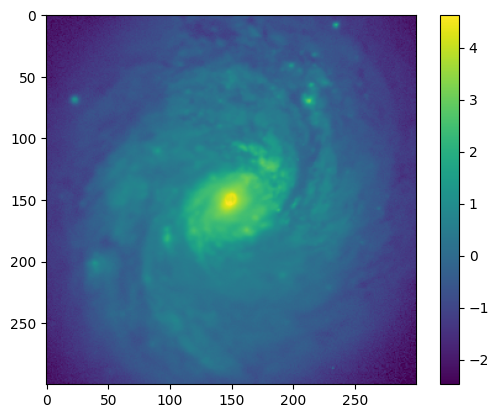

In [ ]:
# Applying Z scale on the log normalized image data and visualizing it
z1,z2 = zscale_interval.get_limits(NGC1068_log_data)
print(z1,z2)
plt.imshow(NGC1068_log_data,vmin=z1,vmax=z2)
plt.colorbar()

In [ ]:
NGC1068_log_data.shape  # Shape of the log normalized image

(300, 300)

In [ ]:
NGC1068_center_data = NGC1068_log_data[110:180, 120:180] # cropping image to zoom into center

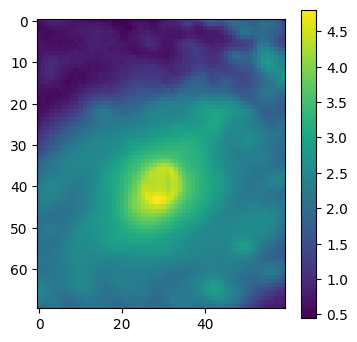

In [ ]:
# Plotting the cropped image
plt.figure(figsize=(4,4))
plt.imshow(NGC1068_center_data)
plt.colorbar()

In [ ]:
# Extracting features from the log normalized image
Featured_image = feature.multiscale_basic_features(NGC1068_log_data)
Featured_image.shape

(300, 300, 24)

In [ ]:
P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,P11,P12,P13,P14,P15,P16,P17,P18,P19,P20,P21,P22,P23,P24= cv2.split(Featured_image)
Pixels = [P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,P11,P12,P13,P14,P15,P16,P17,P18,P19,P20,P21,P22,P23,P24]

<ipython-input-35-df72473e7e79>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f = plt.figure()


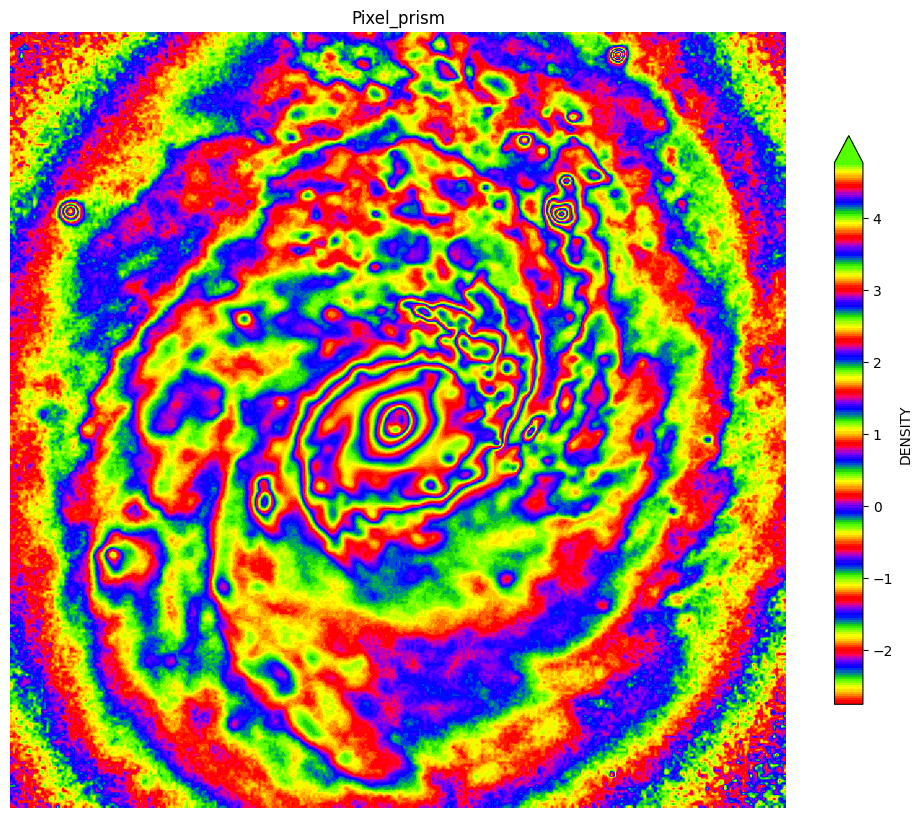

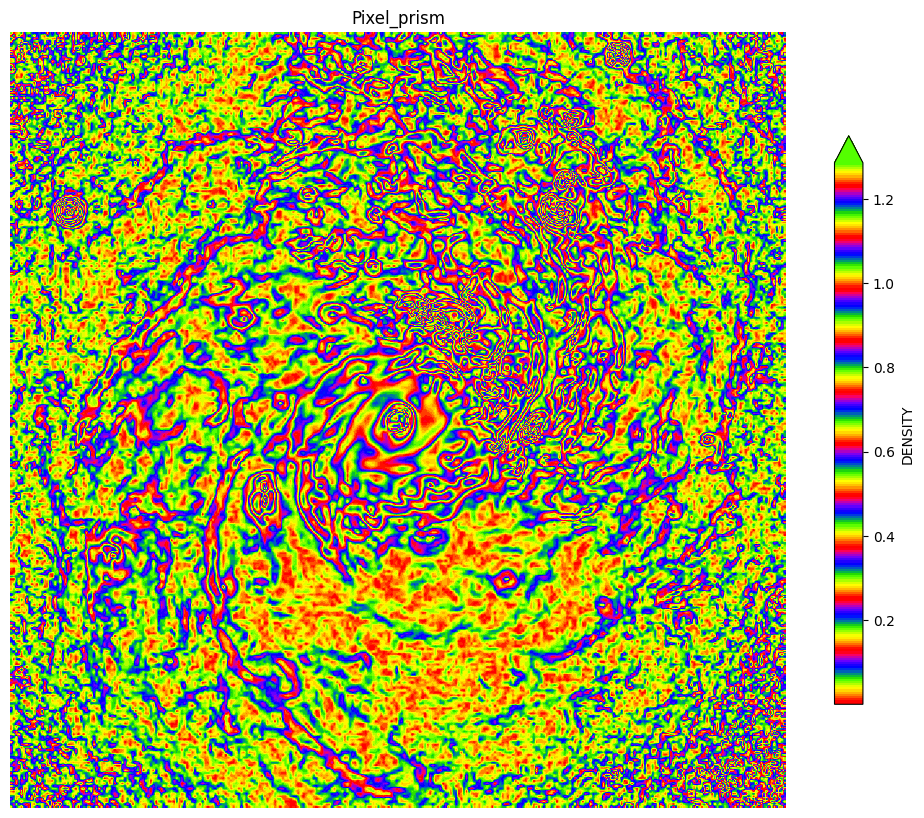

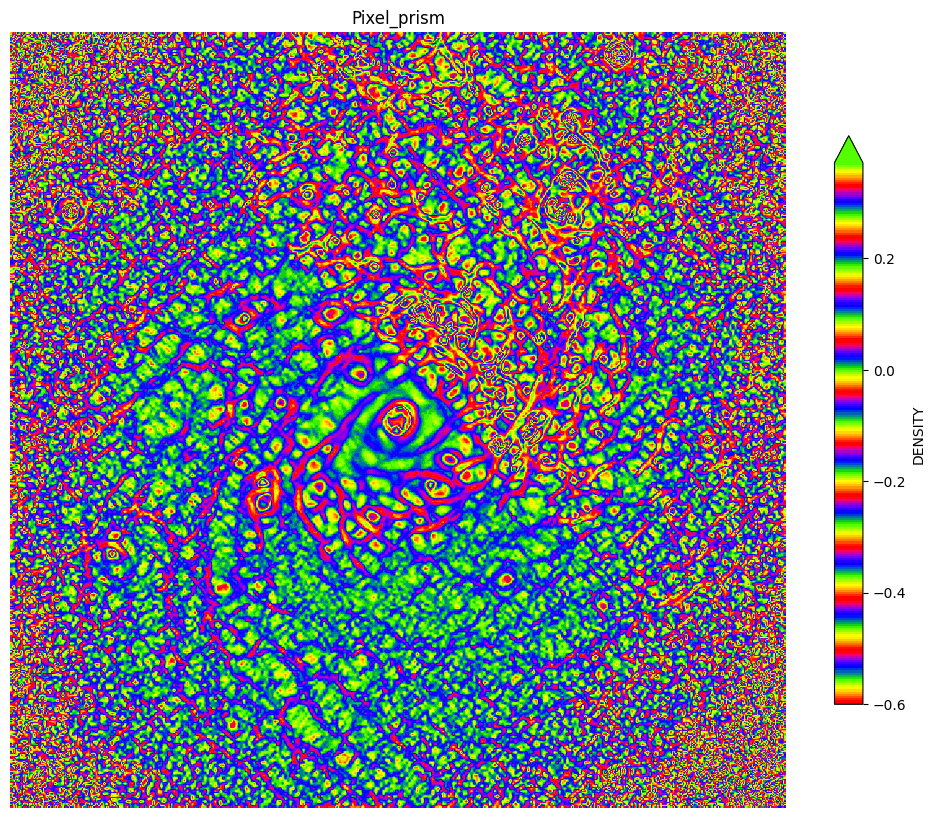

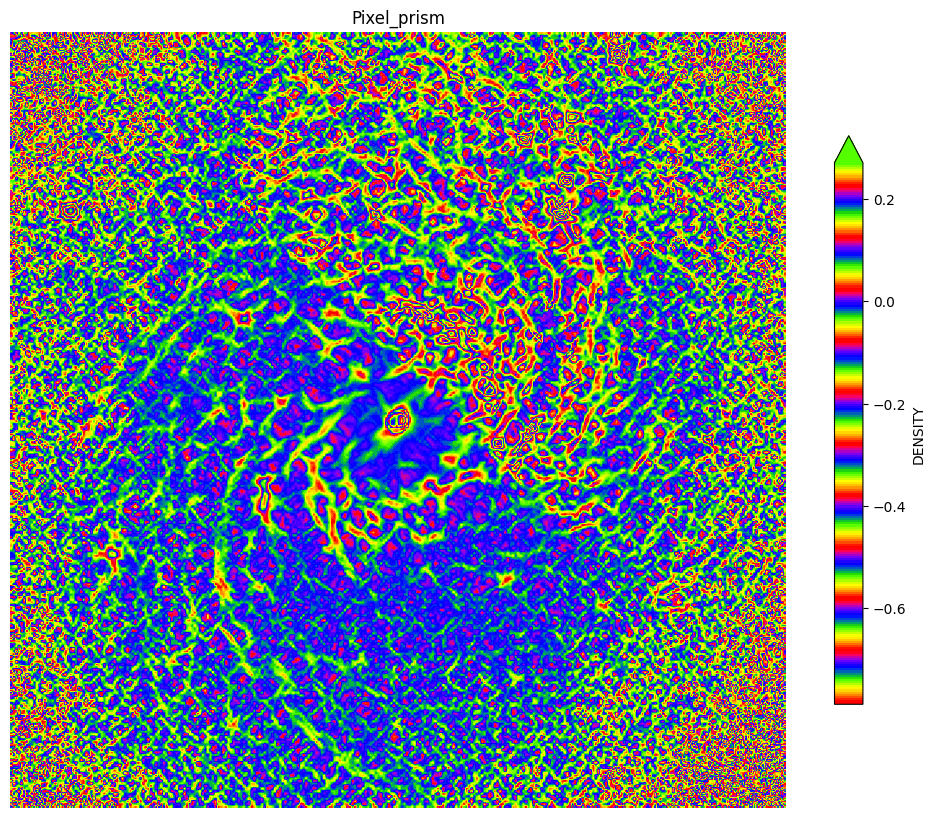

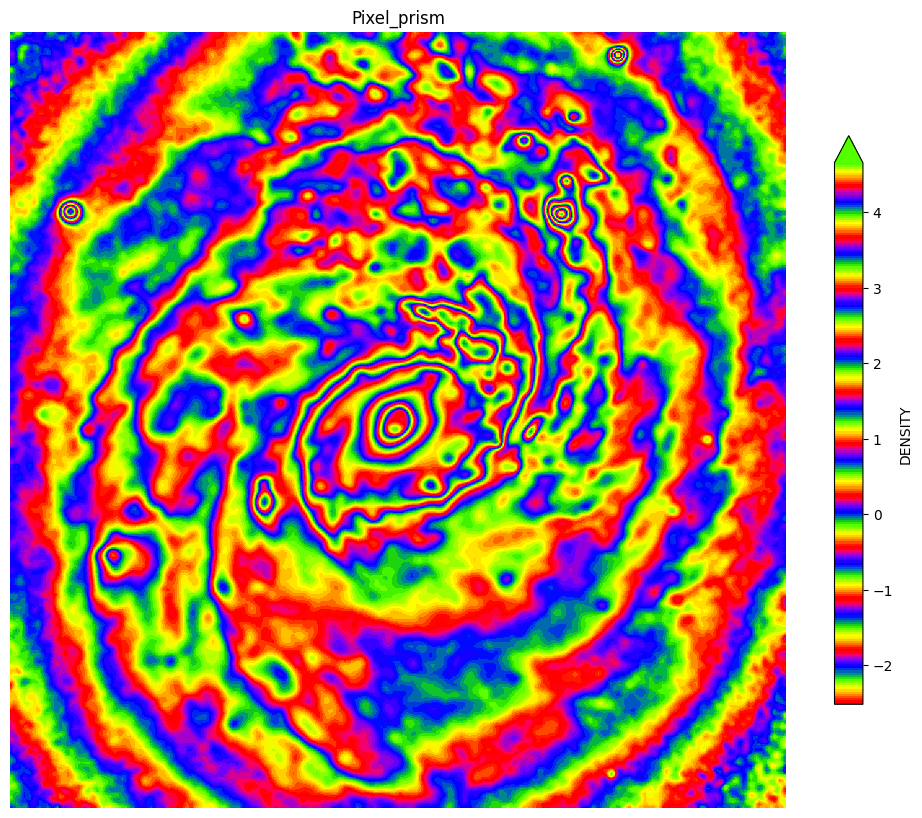

...

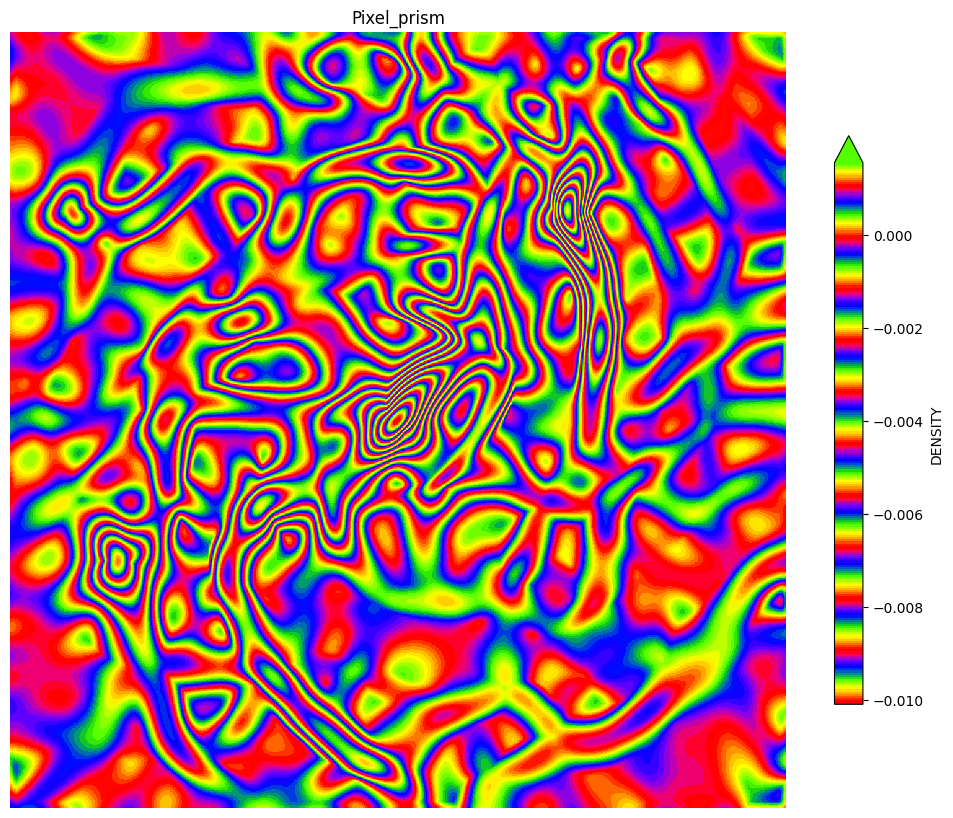

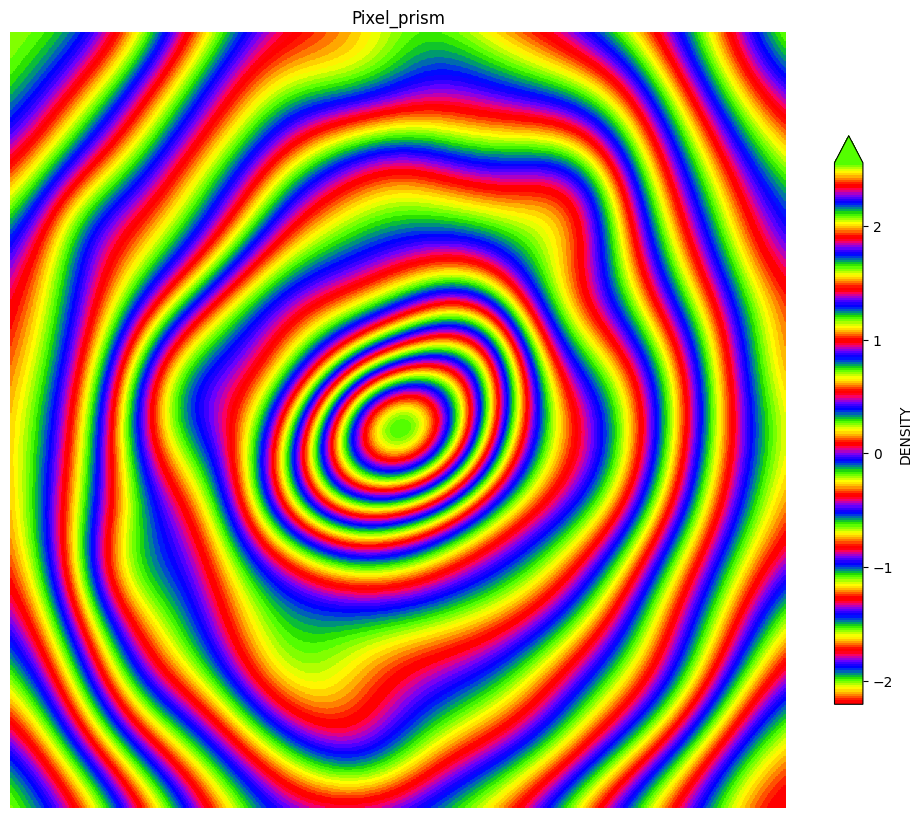

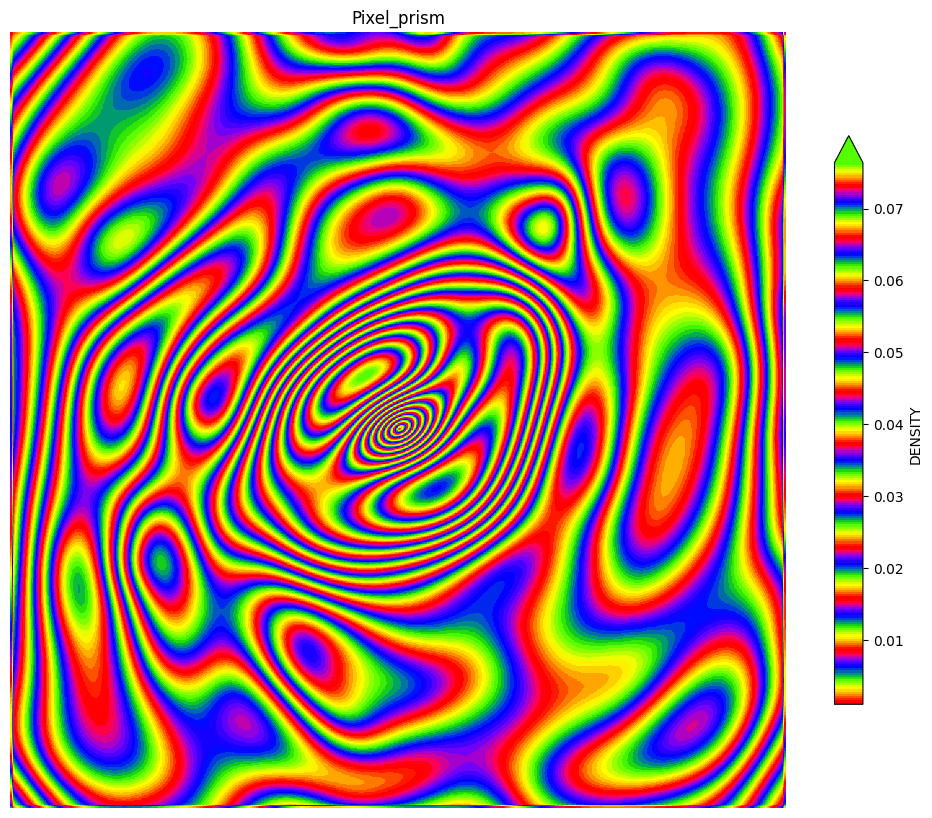

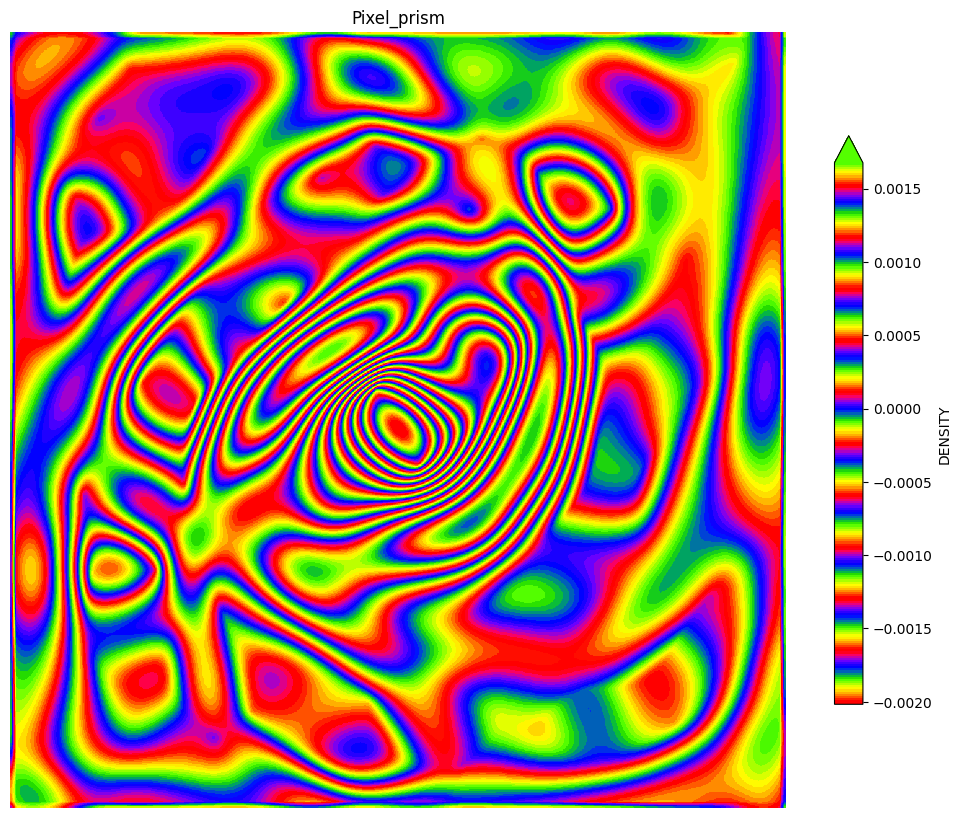

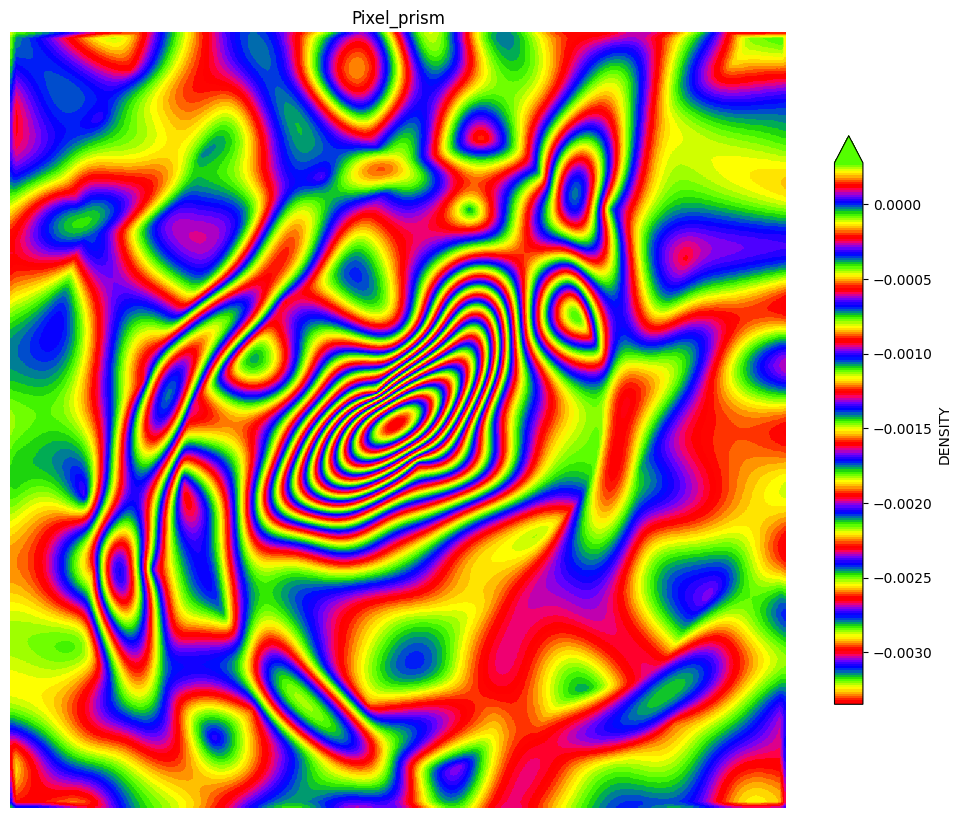

In [ ]:
# ploting the extracted features
for pixel in Pixels:

  f = plt.figure()
  f.set_figwidth(10)
  f.set_figheight(10)
  plt.imshow(pixel,cmap = 'prism')
  plt.title("Pixel_prism")
  plt.axis("off")

  plt.tight_layout()
  plt.colorbar(shrink=0.6,label="DENSITY",extend="max")

Inference from the EDA

In [ ]:
'''
From the EDA performed above we can infer that:
1) the quitorial longitude and latitude measured along J2000.0 frame are 40.6696292 and -0.0132806 respectively.
2) The size of the image is 300 by 300
3) The quantitative analysis (min, max, mean, std) shows that the pixel values are left skewed as can be observed in histogram
4) By normalizing/standardizing the pixels we can observe the spiral nature of the galazy
5) By Z scaling the pixels we can observe that the galaxy has a very high intensity in the core
6) Feature extractions shows the spiral rings and high density core of the galaxy
'''

'\nFrom the EDA performed above we can infer that:\n1) the quitorial longitude and latitude measured along J2000.0 frame are 40.6696292 and -0.0132806 respectively.\n2) The size of the image is 300 by 300\n3) The quantitative analysis (min, max, mean, std) shows that the pixel values are left skewed as can be observed in histogram\n4) By normalizing/standardizing the pixels we can observe the spiral nature of the galazy\n5) By Z scaling the pixels we can observe that the galaxy has a very high intensity in the core \n6) Feature extractions shows the spiral rings and high density core of the galaxy\n'

# Q6 (15 Points)

To prove your hypothesis in question 4 and have better insights on data:
  - Use atleast 4 filters and view them in atleast 5 different colormaps.

  - Provide a complete summary for every filter explaining what type of insights we are getting by applying it.

  - Write on which filter and colormap gave better insights

In [ ]:
# import necessary libraries

# Get dataset

# Open the fits data

# Perform filtering



In [ ]:
colors = ['gray', 'jet', 'magma', 'OrRd', 'copper']

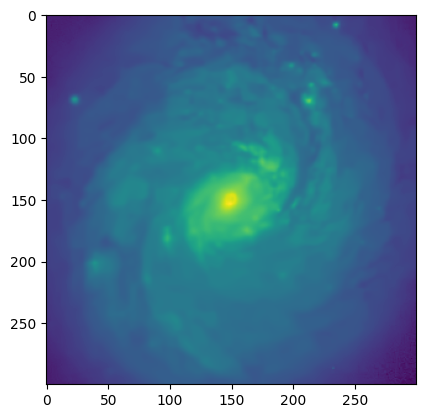

In [ ]:
# Denoising the log normalized image using BM3D filter
BM3D_denoised_image = bm3d.bm3d(NGC1068_log_data, sigma_psd=0.1, stage_arg=bm3d.BM3DStages.HARD_THRESHOLDING)
plt.imshow(BM3D_denoised_image)

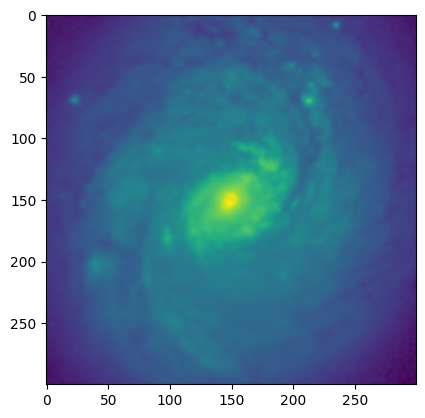

In [ ]:
# denoising log normalized using gaussian filter
gaussian_denoised_image = cv2.GaussianBlur(NGC1068_log_data, (5,5),0)
plt.imshow(gaussian_denoised_image)

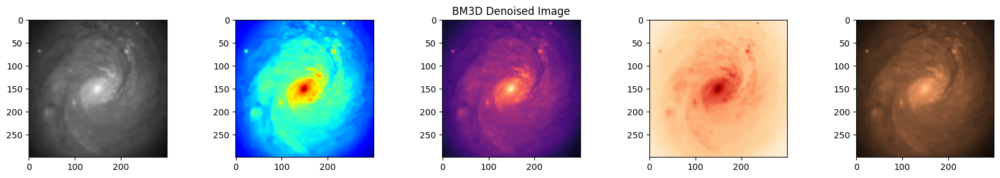

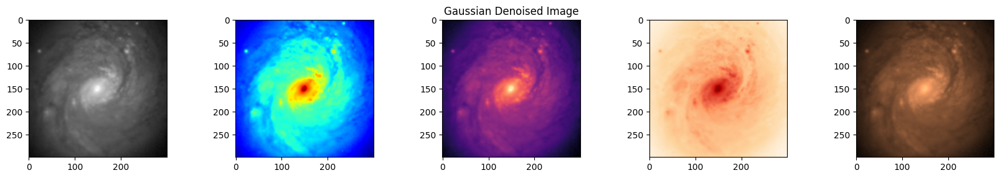

In [ ]:
# Ploting the BM3D denoised image and Gaussian denoised image in different color maps
fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
ax[2].set_title('BM3D Denoised Image')
for i,color in enumerate(colors):
  ax[i].imshow(BM3D_denoised_image, cmap=color)

fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
ax[2].set_title('Gaussian Denoised Image')
for i,color in enumerate(colors):
  ax[i].imshow(gaussian_denoised_image, cmap=color)

In [ ]:
# Applying different edge filters on the log normalized image
robert_img = roberts(NGC1068_log_data)
sobel_img = sobel(NGC1068_log_data)
scharr_img = scharr(NGC1068_log_data)
prewitt_img = prewitt(NGC1068_log_data)


Text(0.5, 1.0, 'Prewitt Image')

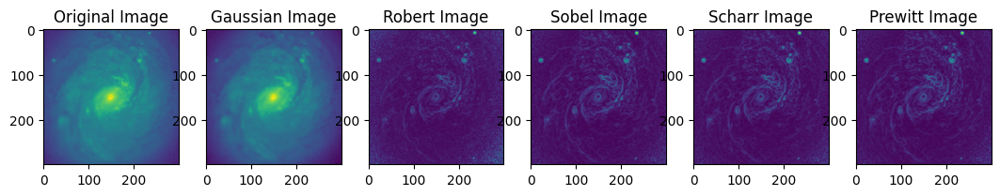

In [ ]:
# Plotting the edge filtered images obtained from above
fig, ax = plt.subplots(1,6, figsize=(13,13))
ax[0].imshow(NGC1068_log_data)
ax[0].set_title('Original Image')
ax[1].imshow(gaussian_denoised_image)
ax[1].set_title('Gaussian Image')
ax[2].imshow(robert_img)
ax[2].set_title('Robert Image')
ax[3].imshow(sobel_img)
ax[3].set_title('Sobel Image')
ax[4].imshow(scharr_img)
ax[4].set_title('Scharr Image')
ax[5].imshow(prewitt_img)
ax[5].set_title('Prewitt Image')

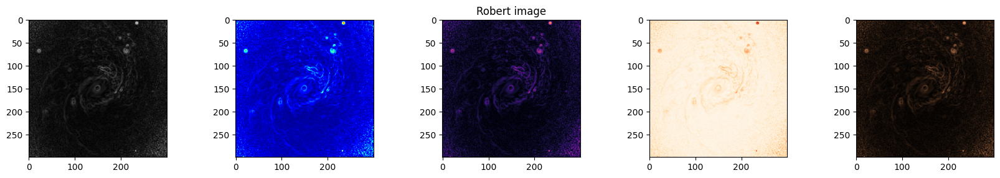

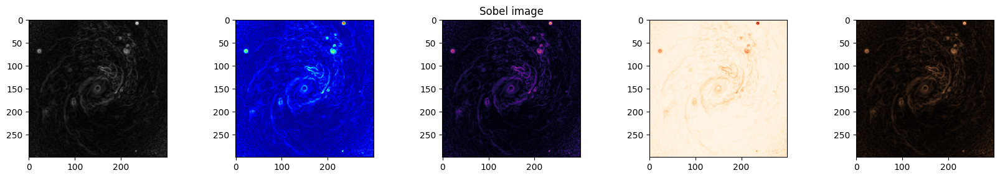

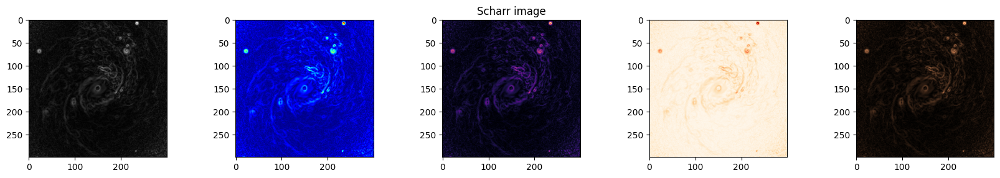

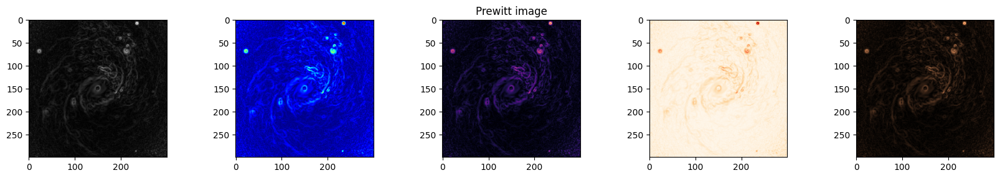

In [ ]:
#  Ploting the edge filtered images in different color maps
edge_filtered_images = [robert_img, sobel_img, scharr_img, prewitt_img]
edge_filtered_names = ['Robert image', 'Sobel image', 'Scharr image', 'Prewitt image']
for img, name in zip(edge_filtered_images,edge_filtered_names):
  fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
  ax[2].set_title(name)
  for i,color in enumerate(colors):
    ax[i].imshow(img, cmap=color)

In [ ]:
# Applying ridge filters on the log normalized image
meijering_img = meijering(NGC1068_log_data)
sato_img = sato(NGC1068_log_data)

Text(0.5, 1.0, 'Sato Image')

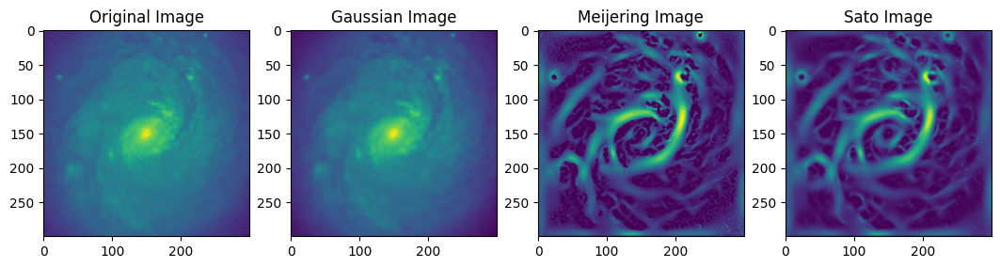

In [ ]:
#  Plotting the ridge filtered images
fig, ax = plt.subplots(1,4, figsize=(13,13))
ax[0].imshow(NGC1068_log_data)
ax[0].set_title('Original Image')
ax[1].imshow(gaussian_denoised_image)
ax[1].set_title('Gaussian Image')
ax[2].imshow(meijering_img)
ax[2].set_title('Meijering Image')
ax[3].imshow(sato_img)
ax[3].set_title('Sato Image')

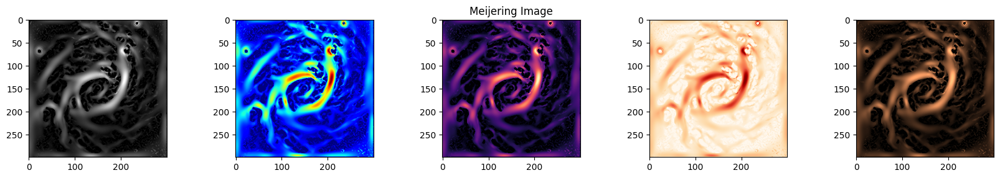

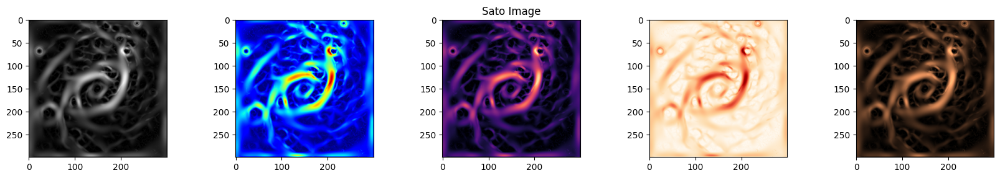

In [ ]:
# Ploting the ridge filtered images in different color maps
ridge_filtered_images = [meijering_img, sato_img]
ridge_filtered_names = ['Meijering Image', 'Sato Image']
for img, name in zip(ridge_filtered_images,ridge_filtered_names):
  fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
  ax[2].set_title(name)
  for i,color in enumerate(colors):
    ax[i].imshow(img, cmap=color)

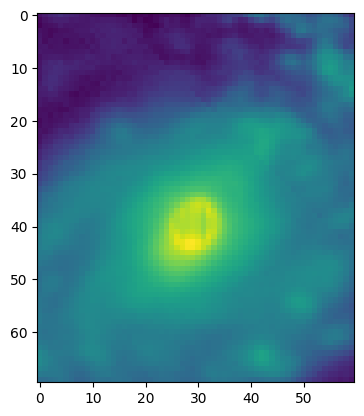

In [ ]:
# Sharpening the cropped image
sharpen_filter=np.array([[-1,-1,-1],[-1,25,-1], [-1,-1,-1]]) # creating a sharpening filter
center_sharp_image=cv2.filter2D(NGC1068_center_data,-1,sharpen_filter) # applying the filter
plt.imshow(center_sharp_image)

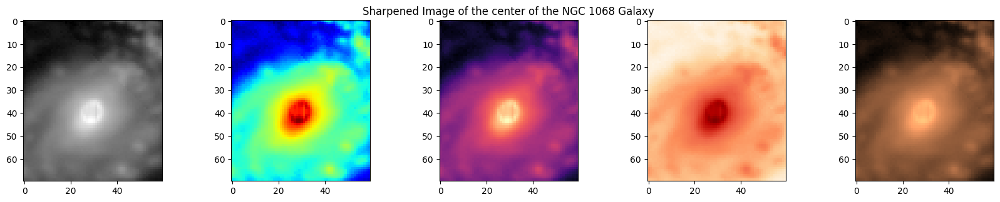

In [ ]:
# Ploting the sharpened image in different color maps
fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
ax[2].set_title('Sharpened Image of the center of the NGC 1068 Galaxy')
for i,color in enumerate(colors):
  ax[i].imshow(center_sharp_image, cmap=color)

In [ ]:
# Apply a high-pass filter to remove low-frequency components on the gaussian denoised image
NGC1068_fft_image = fftshift(fft2(gaussian_denoised_image))
cutoff_freq = 10  # Adjusting the cutoff frequency as needed
mask = np.ones_like(NGC1068_fft_image)  # Creating an array of same size of the NGC1068_fft_image
center_x, center_y = np.array(NGC1068_fft_image.shape) // 2   # Taking the center points of the image
mask[center_x - cutoff_freq: center_x + cutoff_freq,
     center_y - cutoff_freq: center_y + cutoff_freq] = 0  # making the middle region 0 to make a mask that filters the low frequency
NGC1068_filtered_image = NGC1068_fft_image * mask   # applying mask
fft_filtered_image = np.abs(np.fft.ifft2(np.fft.ifftshift(NGC1068_filtered_image)))   # applying inverse fft to obtain the filtered image


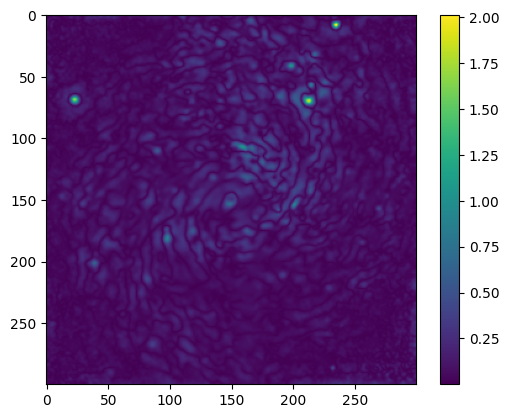

In [ ]:
# Ploting the FFT filtered image
plt.imshow(fft_filtered_image)
plt.colorbar()

In [ ]:
# Zooming in the center
fft_filtered_center = fft_filtered_image[100:200, 100:200]

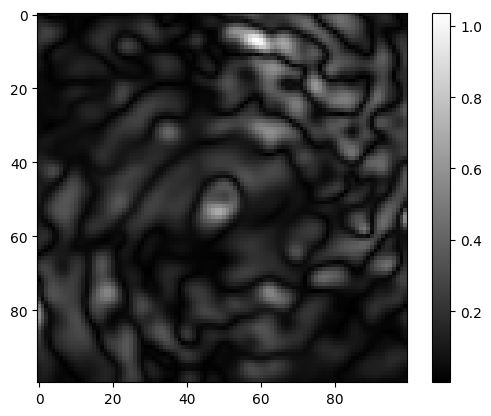

In [ ]:
# Ploting the zoomed image to lokk at the center
plt.imshow(fft_filtered_center, cmap='gray')
plt.colorbar()

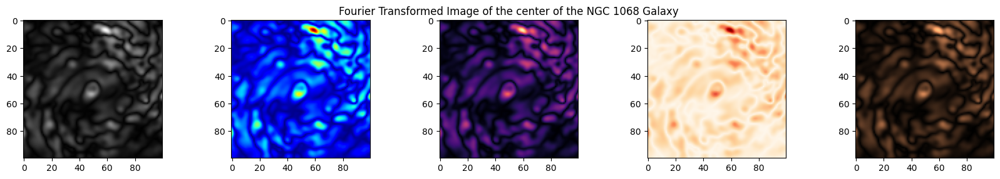

In [ ]:
# Plotting the zommed image in different color maps
fig, ax = plt.subplots(1,5,figsize=(20,20), gridspec_kw={'wspace':0.5, 'hspace':0})
ax[2].set_title('Fourier Transformed Image of the center of the NGC 1068 Galaxy')
for i,color in enumerate(colors):
  ax[i].imshow(fft_filtered_center, cmap=color)

Filters used and conclusion drawn from them

In [1]:
'''
1) Smoothing Filters:
  - Smoothing filters smooths images by reducing noise and blurring edges. I have applied BM3D and Gaussian filters.
  - It shows that there may be some spiral arms in the galaxy and there can be high intensity at the center
  - From magma color map we can see that there are some spiral arms in the galaxy and high intensity at its center

2) Edge Filters:
  - Edge Filters detects edges by computing the gradients. I have robert, sobel, scharr, prewiit filters. All of them are giving similar results.
  - They are showing spirals more prominently than gaussian denoising filter. From here we can infer that it is a spiral galaxy

3) Ridge Filters:
  - Ridge filters detect ridge/valleys in the image based on the eigenvalues. i have applied Meijering and Sato filters.
  - Here we can see that the galaxy have ridges along its spiral arms and mostly at near the center.

4) Frequency Domain Filters:
  - Fourier Transform: Converts an image from spatial domain to frequency domain
  - High-pass Filtering: Removes low-frequency components to enhance edges and details.
  - I have used Fourier transform and High Pass filter to focus on the center of the galaxy.
  - From this we can see that there is h high frequency ring formed at the center inside which there is a very low (negligible) frequency. It infers that there is a black
    hole at the center of the galaxy.
  - Zooming at the center and applying jet and magma color map we can see the results.

From all above points we can conclude that M77 galaxy is a spiral galaxy and has a black hole in its center.
'''



'\n1) Smoothing Filters:\n  - Smoothing filters smooths images by reducing noise and blurring edges. I have applied BM3D and Gaussian filters.\n  - It shows that there may be some spiral arms in the galaxy and there can be high intensity at the center\n  - From magma color map we can see that there are some spiral arms in the galaxy and high intensity at its center\n\n2) Edge Filters:\n  - Edge Filters detects edges by computing the gradients. I have robert, sobel, scharr, prewiit filters. All of them are giving similar results.\n  - They are showing spirals more prominently than gaussian denoising filter. From here we can infer that it is a spiral galaxy\n\n3) Ridge Filters:\n  - Ridge filters detect ridge/valleys in the image based on the eigenvalues. i have applied Meijering and Sato filters.\n  - Here we can see that the galaxy have ridges along its spiral arms and mostly at near the center.\n\n4) Frequency Domain Filters:\n  - Fourier Transform: Converts an image from spatial doma